In [27]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots

# Bronze layer

In [28]:
# Check bronze layer
df = pd.read_parquet('data/bronze/df.parquet')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2014-10-24 00:00:00+02:00  ->  2024-09-30 19:00:00+02:00


,Forecasted Load,Actual Load
2024-09-30 17:00:00+02:00,7390.0,NaN
2024-09-30 18:00:00+02:00,8676.0,NaN
2024-09-30 19:00:00+02:00,7486.0,NaN


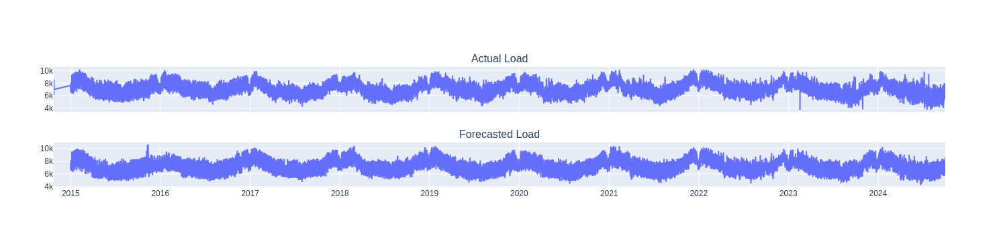

In [30]:
# Plot the full bronze data
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("Actual Load", "Forecasted Load"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Actual Load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Forecasted Load').data[0],
    row=2, col=1
)

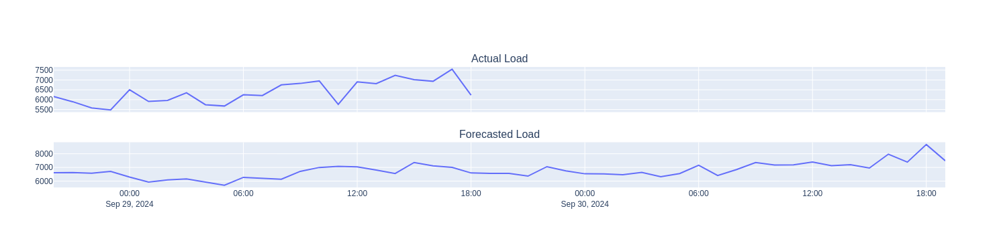

In [31]:
# Plot the last 48 entries of the bronze data
df = df.iloc[-48:]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("Actual Load", "Forecasted Load"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Actual Load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Forecasted Load').data[0],
    row=2, col=1
)

- The Forecasted Load should be ranging 48h
- The Actual Load should only have 24 values
- The latest Actual Load value should have a timestamp corresponding to the datetime of the last locally-run `\update-forecast`

# Silver layer

In [32]:
# Check silver layer
df = pd.read_parquet('data/silver/df.parquet')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2014-10-23 00:00:00+02:00  ->  2024-09-29 19:00:00+02:00


,24h_later_forecast,24h_later_load
2024-09-29 17:00:00+02:00,7390.0,NaN
2024-09-29 18:00:00+02:00,8676.0,NaN
2024-09-29 19:00:00+02:00,7486.0,NaN


In [33]:
# Plot the full silver data
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("24h_later_load", "24h_later_forecast"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_forecast').data[0],
    row=2, col=1
)

In [34]:
# Plot the last 48 entries of the silver data
df = df.iloc[-48:]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("24h_later_load", "24h_later_forecast"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_forecast').data[0],
    row=2, col=1
)

- The 24h_later_forecast should be ranging 48h
- The 24h_later_load should only have 24 values
- The latest 24h_later_load value should have a timestamp corresponding to the datetime of the last locally-run `\update-forecast`, minus 24h

# Gold layer

In [35]:
# Check gold layer
df = pd.read_parquet('data/gold/df.parquet')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2015-01-08 01:00:00+01:00  ->  2024-09-29 18:00:00+02:00


,24h_later_load,year,month,day,hour,weekday,1h_ago_load,2h_ago_load,3h_ago_load,24h_ago_load,7d_ago_load,8h_min,8h_max,8h_median,24h_min,24h_max,24h_median,7d_min,7d_max,7d_median
2024-09-29 16:00:00+02:00,NaN,2024,9,29,16,6,7017.0,7236.0,6812.0,7592.0,6065.0,5758.0,7236.0,6904.0,5481.0,7592.0,6346.0,4315.0,8037.0,6550.0
2024-09-29 17:00:00+02:00,NaN,2024,9,29,17,6,6935.0,7017.0,7236.0,6913.0,5473.0,5758.0,7546.0,6935.0,5481.0,7546.0,6346.0,4315.0,8037.0,6574.0
2024-09-29 18:00:00+02:00,NaN,2024,9,29,18,6,7546.0,6935.0,7017.0,6418.0,5085.0,5758.0,7546.0,6935.0,5481.0,7546.0,6268.0,4315.0,8037.0,6574.0


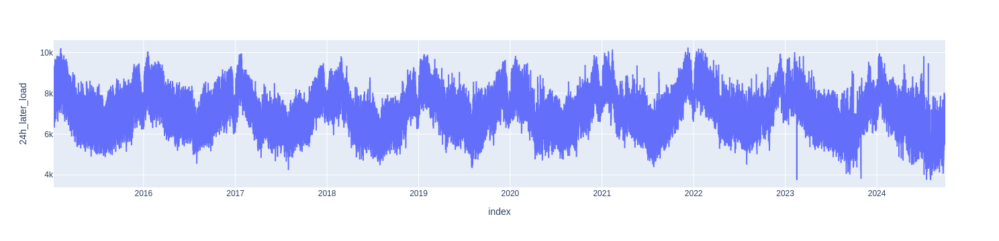

In [36]:
# Plot the full gold data
px.line(df.reset_index(), x='index', y='24h_later_load')

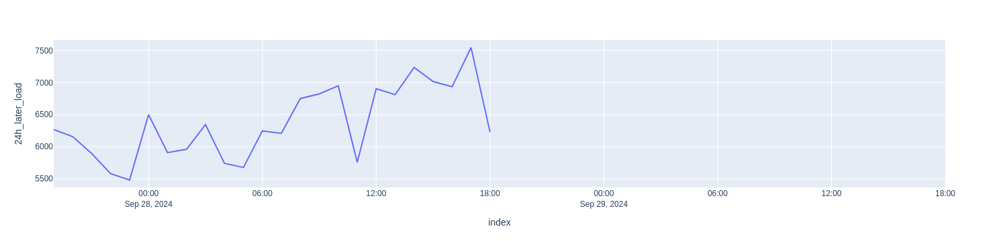

In [37]:
# Plot the last 48 entries of the gold data
df = df.iloc[-48:]
px.line(df.reset_index(), x='index', y='24h_later_load')